# Figuring Out Bottlenecks and Failure Modes

In [1]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

In [2]:
sys.path.append('../')

In [3]:
PATH = '../../scratch/aorl/e2e_maze_8_2/e2e_maze_8_2.a5406616b3951230fafa4ca948138750f5881270649f6138153e795abde02629'
RUN_NAME = 'e2e_maze_8_2.a5406616b3951230fafa4ca948138750f5881270649f6138153e795abde02629'
PROJECT_NAME = 'aorl'
ENTITY = 'jnzhao3'

In [4]:
import wandb
api = wandb.Api()
run = api.runs(f'{ENTITY}/{PROJECT_NAME}', filters={'display_name': f'{RUN_NAME}'})[0]

In [5]:
from utils.flax_utils import restore_agent, save_agent
from agents import agents

config = run.config['agent']
agent_class = agents[config['agent_name']]

In [6]:
from utils.datasets import GCDataset, Dataset
import pathlib
from wrappers.datafuncs_utils import make_env_and_datasets

DATA_STEP = 3000000

dataset_path = pathlib.Path(PATH) / f'data-{DATA_STEP}.npz'
env, train_dataset, val_dataset = make_env_and_datasets(run.config['env_name'], dataset_path=str(dataset_path), use_oracle_reps=True)
dataset_class = GCDataset
train_dataset = dataset_class(Dataset.create(**train_dataset, freeze=False), config)

/home/jennifer/miniconda3/envs/aorl/lib/python3.10/site-packages/Cython/Distutils/old_build_ext.py:15: DeprecationWarning: dep_util is Deprecated. Use functions from setuptools instead.
  from distutils.dep_util import newer, newer_group
/home/jennifer/miniconda3/envs/aorl/lib/python3.10/site-packages/Cython/Distutils/old_build_ext.py:15: DeprecationWarning: dep_util is Deprecated. Use functions from setuptools instead.
  from distutils.dep_util import newer, newer_group
<frozen importlib._bootstrap>:283: DeprecationWarning: the load_module() method is deprecated and slated for removal in Python 3.12; use exec_module() instead


In [7]:
save_dir = PATH
step = 1000000

example_batch = train_dataset.sample(1)
agent = agent_class.create(
    run.config['seed'],
    example_batch,
    config
)

agent = restore_agent(agent, save_dir, step)

Restored from ../../scratch/aorl/e2e_maze_8_2/e2e_maze_8_2.a5406616b3951230fafa4ca948138750f5881270649f6138153e795abde02629/params_1000000.pkl


In [8]:
from env_wrappers import MazeEnvWrapper

env = MazeEnvWrapper(env)

all_cells = env.all_cells

In [9]:
def plot_heatmap(data, xlabel, ylabel, title):
    # your dict (example)
    d = data

    # --- build grid ---
    xs = np.array([x for (x, y) in d.keys()], dtype=float)
    ys = np.array([y for (x, y) in d.keys()], dtype=float)

    x_min, x_max = int(np.floor(xs.min())), int(np.ceil(xs.max()))
    y_min, y_max = int(np.floor(ys.min())), int(np.ceil(ys.max()))

    # edges for 1x1 squares: [x_min, x_min+1, ..., x_max+1]
    x_edges = np.arange(x_min, x_max + 2, 1)
    y_edges = np.arange(y_min, y_max + 2, 1)

    # cell values (ny rows by nx cols); use NaN for "missing" cells
    Z = np.full((len(y_edges) - 1, len(x_edges) - 1), np.nan, dtype=float)

    # fill Z: row index corresponds to y, col index corresponds to x
    for (x, y), val in d.items():
        i = int(round(x)) - x_min  # column
        j = int(round(y)) - y_min  # row
        Z[j, i] = val

    # --- plot ---
    fig, ax = plt.subplots(figsize=(6, 6))
    m = ax.pcolormesh(x_edges, y_edges, Z, shading="flat")  # cells are 1x1 by construction
    fig.colorbar(m, ax=ax, label="density")

    plt.scatter(x=all_cells[:, 0], y=all_cells[:, 1], s=10, c='gray', alpha=1.0)
    for i in range(len(all_cells)):
        plt.annotate(f'{(all_cells[i, 0], all_cells[i, 1])}', (all_cells[i, 0], all_cells[i, 1]), xytext=(2, 2), textcoords='offset points', c='gray')

    ax.set_aspect("equal")
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)

    plt.show()

## Loading the Dataset

In [10]:
import numpy as np
data_100000 = np.load(f'{PATH}/data-100000.npz')

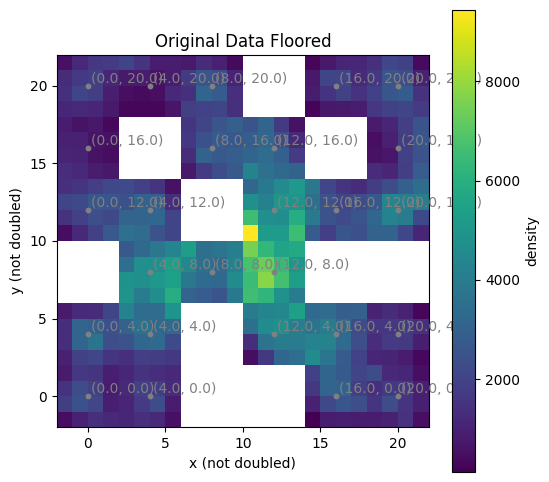

In [11]:
original_data_floored = {}
floored = np.floor(data_100000['observations'])

for i in range(len(floored)):
    rounded = (floored[i][0], floored[i][1])
    if rounded in original_data_floored:
        original_data_floored[rounded] += 1
    else:
        original_data_floored[rounded] = 1

plot_heatmap(original_data_floored, 'x (not doubled)', 'y (not doubled)', 'Original Data Floored')

In [12]:
original_data_floored.keys()

dict_keys([(3.0, 7.0), (3.0, 8.0), (3.0, 9.0), (2.0, 9.0), (2.0, 10.0), (2.0, 11.0), (1.0, 11.0), (1.0, 12.0), (0.0, 12.0), (0.0, 13.0), (-1.0, 13.0), (-2.0, 13.0), (-2.0, 12.0), (-2.0, 11.0), (-2.0, 10.0), (-1.0, 10.0), (0.0, 10.0), (0.0, 11.0), (-1.0, 11.0), (1.0, 10.0), (1.0, 13.0), (0.0, 14.0), (-1.0, 14.0), (-2.0, 14.0), (-1.0, 12.0), (1.0, 14.0), (3.0, 10.0), (4.0, 9.0), (4.0, 8.0), (5.0, 8.0), (5.0, 7.0), (5.0, 6.0), (6.0, 6.0), (4.0, 6.0), (3.0, 6.0), (3.0, 5.0), (2.0, 5.0), (2.0, 4.0), (1.0, 4.0), (1.0, 3.0), (0.0, 3.0), (0.0, 2.0), (0.0, 1.0), (-1.0, 1.0), (-1.0, 0.0), (-1.0, -1.0), (-1.0, -2.0), (0.0, -1.0), (0.0, 0.0), (1.0, 0.0), (1.0, 1.0), (1.0, 2.0), (2.0, 3.0), (2.0, 6.0), (4.0, 10.0), (4.0, 11.0), (4.0, 12.0), (3.0, 12.0), (3.0, 13.0), (2.0, 13.0), (0.0, 15.0), (0.0, 16.0), (0.0, 17.0), (0.0, 18.0), (-1.0, 18.0), (-1.0, 19.0), (-1.0, 20.0), (-1.0, 21.0), (0.0, 21.0), (1.0, 21.0), (2.0, 21.0), (3.0, 21.0), (16.0, 4.0), (15.0, 4.0), (15.0, 3.0), (14.0, 3.0), (13.0, 3.0)

In [13]:
START_XY = (12.0, 8.0)
GOAL_XYS = list(original_data_floored.keys())
START_IJ = env.unwrapped.xy_to_ij(START_XY)

task_infos = []

# for goal_xy in GOAL_XYS:
for i in range(4):
    goal_xy = GOAL_XYS[i]
    task_info = {
        'task_name': f'{goal_xy}',
        'init_ij': START_IJ,
        'init_xy': START_XY,
        'goal_ij': env.unwrapped.xy_to_ij(goal_xy),
        'goal_xy': goal_xy
    }

    task_infos.append(task_info)

In [14]:
env.task_infos = task_infos
eval_metrics, all_trajs = env.evaluate_step(agent=agent, config=config, eval_episodes=1, return_trajs=True)

  0%|          | 0/4 [00:00<?, ?it/s]

100%|██████████| 4/4 [00:16<00:00,  4.20s/it]


In [15]:
all_trajs

{'evaluation/(3.0, 7.0)': [defaultdict(list,
              {'observation': [array([ 1.24303787e+01,  8.20552675e+00, -7.20857672e-01, -1.16642621e+00,
                       -3.74025391e-01, -3.27198943e-01,  2.80850469e-01, -1.91581898e+00,
                       -2.35865572e+00,  3.42546000e-02,  7.27087943e-01,  1.88654337e-02,
                       -1.00191558e+00, -1.16746782e+00, -7.19810871e-01, -3.01776242e-01,
                        6.95075282e-01, -2.73134803e-01, -8.89215379e-01, -8.04055947e-01,
                       -2.53065861e-01,  2.97540248e-01, -1.51390061e+00,  1.51683862e+00,
                        2.90600075e-01,  4.27034844e-01, -4.12424953e-01,  9.05114927e-01,
                       -4.34712838e-01, -2.99547489e-01,  1.35661204e-01, -6.15377324e-01,
                       -1.94308364e-01,  2.00384973e-01, -4.90630699e-01, -2.19009747e-01,
                        2.60053482e-01,  9.61518546e-01,  8.86243287e-02, -1.05764298e-01,
                        1.1091

In [16]:
eval_metrics

{'evaluation/(3.0, 7.0)_success': 1.0,
 'evaluation/(3.0, 8.0)_success': 0.0,
 'evaluation/(3.0, 9.0)_success': 0.0,
 'evaluation/(2.0, 9.0)_success': 0.0,
 'evaluation/overall_success': 0.25}

In [24]:
np.array(all_trajs['evaluation/(3.0, 7.0)'][0]['observation']).shape

(138, 69)

(2.0, 9.0)


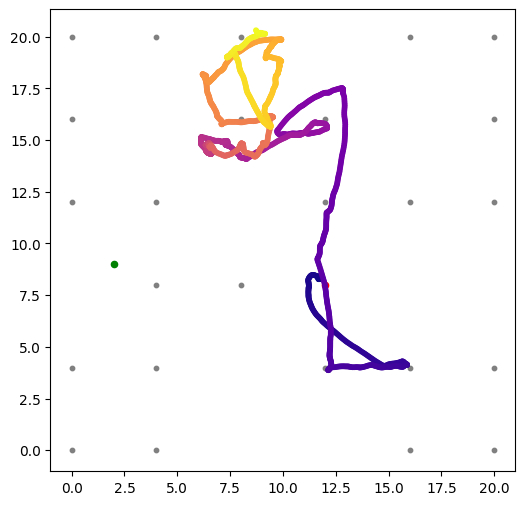

In [35]:
plt.figure(figsize=(6, 6))

plt.scatter(x=all_cells[:, 0], y=all_cells[:, 1], s=10, c='gray', alpha=1.0)
# for i in range(len(all_cells)):
#     plt.annotate(f'{(all_cells[i, 0], all_cells[i, 1])}', (all_cells[i, 0], all_cells[i, 1]), xytext=(2, 2), textcoords='offset points', c='gray')

plt.scatter(x=[START_XY[0]], y=[START_XY[1]], s=20, c='red')


# for k, v in all_trajs.items():
k = list(all_trajs.keys())[3]
goal_xy = eval(k[11 : ])
print(goal_xy)
x = np.array(all_trajs[k][0]['observation'])[:, 0]
y = np.array(all_trajs[k][0]['observation'])[:, 1]

plt.scatter(x=x, y=y, c=range(len(x)), cmap='plasma', s=10)
plt.scatter(x=[goal_xy[0]], y=[goal_xy[1]], c='green', s=20)

plt.show()

## Starting from a Corner Location

In [36]:
START_XY = (0.0, 20.0)
GOAL_XYS = list(original_data_floored.keys())
START_IJ = env.unwrapped.xy_to_ij(START_XY)

task_infos = []

# for goal_xy in GOAL_XYS:
for i in range(4):
    goal_xy = GOAL_XYS[i]
    task_info = {
        'task_name': f'{goal_xy}',
        'init_ij': START_IJ,
        'init_xy': START_XY,
        'goal_ij': env.unwrapped.xy_to_ij(goal_xy),
        'goal_xy': goal_xy
    }

    task_infos.append(task_info)

env.task_infos = task_infos
eval_metrics, all_trajs = env.evaluate_step(agent=agent, config=config, eval_episodes=1, return_trajs=True)

100%|██████████| 4/4 [00:16<00:00,  4.18s/it]


In [37]:
eval_metrics

{'evaluation/(3.0, 7.0)_success': 0.0,
 'evaluation/(3.0, 8.0)_success': 0.0,
 'evaluation/(3.0, 9.0)_success': 1.0,
 'evaluation/(2.0, 9.0)_success': 0.0,
 'evaluation/overall_success': 0.25}

(3.0, 7.0)


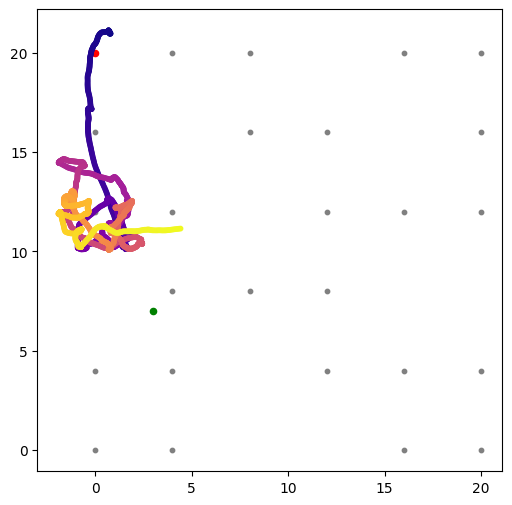

In [42]:
plt.figure(figsize=(6, 6))

plt.scatter(x=all_cells[:, 0], y=all_cells[:, 1], s=10, c='gray', alpha=1.0)

plt.scatter(x=[START_XY[0]], y=[START_XY[1]], s=20, c='red')


# for k, v in all_trajs.items():
k = list(all_trajs.keys())[0]
goal_xy = eval(k[11 : ])
print(goal_xy)
x = np.array(all_trajs[k][0]['observation'])[:, 0]
y = np.array(all_trajs[k][0]['observation'])[:, 1]

plt.scatter(x=x, y=y, c=range(len(x)), cmap='plasma', s=10)
plt.scatter(x=[goal_xy[0]], y=[goal_xy[1]], c='green', s=20)

plt.show()